### Task 2 : Audio Reconstructing using Random Fourier Features (RFF) 

**2.** Audio Reconstruction - Pick a 5-second audio sample of your liking. Use Random Fourier Features (RFF) and Linear Regression to learn the mapping from time
(
t
)
 to amplitude
(
A
)
, where
t
 is the time point, and
A
 is the audio amplitude at that time. Play the reconstructed audio and the original audio to demonstrate reconstruction. Calculate the Root Mean Squared Error (RMSE) and Signal-to-Noise Ratio (SNR) to evaluate the reconstruction. 



1. The audio file *"River Flows in You"* by Yiruma was loaded and converted to mono. A specific 5-second segment (from 35 to 40 seconds) was extracted for reconstruction.

2. The time indices corresponding to each audio sample were normalized to a fixed range. These time values served as inputs, while the corresponding amplitude values were used as targets.

3. To map the time values to a higher-dimensional space, Random Fourier Features (RFF) were generated using `RBFSampler` with 10,000 features and a sigma value of 0.01.

4. A linear regression model was trained on the transformed features to learn the relationship between time and amplitude. This model was then used to reconstruct the audio signal by predicting the amplitude values.

5. The reconstructed audio waveform was compared visually against the original, and both were played back to assess perceptual quality. Additionally, the reconstruction was evaluated using Root Mean Squared Error (RMSE) and Signal-to-Noise Ratio (SNR) metrics.


In [12]:
import torch
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
import soundfile
from IPython.display import Audio
%matplotlib inline
%config InlineBackend.figure_format = "retina"

In [13]:
import torchaudio
from IPython.display import Audio, display

# Path to uploaded file in Kaggle
path = '/kaggle/input/yiruma-riverflowsinyou/Yiruma-RiverFlowsInYou.wav'

# Load the audio
audio, sr = torchaudio.load(path)
print(f"Audio shape: {audio.shape}, Sample rate: {sr} Hz")


# Duration
duration_sec = audio.shape[1] / sr       # duration = samples/sample_rate = seconds
print(f"Uploaded audio length: {duration_sec:.2f} seconds")

# Play full audio
print("Playing audio:")
display(Audio(audio.numpy(), rate=sr))



Audio shape: torch.Size([2, 8326656]), Sample rate: 44100 Hz
Uploaded audio length: 188.81 seconds
Playing audio:


In [14]:
# Convert stereo to mono by selecting first channel
audio = audio[0]  # Now shape is [N]
print(f"Audio shape after selecting first channel: {audio.shape}")

# Crop 5-second segment from a specific start time
start_sec = 35
end_sec = start_sec + 5

crop_audio = audio[int(start_sec * sr):int(end_sec * sr)]
print(f"Cropped shape: {crop_audio.shape}")

# Confirm duration
tm = crop_audio.shape[0] / sr
print(f"Cropped Audio length: {tm:.2f} seconds")

# Play the cropped audio
print("Playing cropped 5-second audio:")
display(Audio(crop_audio.numpy(), rate=sr))

Audio shape after selecting first channel: torch.Size([8326656])
Cropped shape: torch.Size([220500])
Cropped Audio length: 5.00 seconds
Playing cropped 5-second audio:


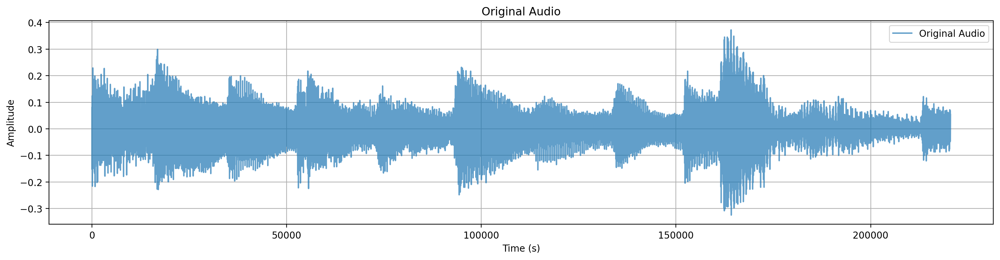

In [15]:
plt.figure(figsize=(15, 4))
plt.plot(crop_audio, alpha = 0.7, label = 'Original Audio')
plt.title("Original Audio")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [16]:
X = torch.arange(0, len(crop_audio)).unsqueeze(1).float()
X = X / X.max() * 200 - 100
print(X.shape)
print(X)

torch.Size([220500, 1])
tensor([[-100.0000],
        [ -99.9991],
        [ -99.9982],
        ...,
        [  99.9982],
        [  99.9991],
        [ 100.0000]])


In [17]:
from sklearn.kernel_approximation import RBFSampler

def create_rff_features(X, num_features, sigma):
    rff = RBFSampler(n_components = num_features, gamma = 1 / (2 * sigma**2), random_state = 13)
    X = X.cpu().numpy()
    X = rff.fit_transform(X)
    return torch.tensor(X, dtype = torch.float32)

In [18]:
num_features = 10000
sigma = 0.01

X_rff = create_rff_features(X, num_features, sigma)
print(X_rff.shape)
print(X_rff)

torch.Size([220500, 10000])
tensor([[ 0.0141, -0.0141,  0.0101,  ..., -0.0129,  0.0141, -0.0132],
        [ 0.0141, -0.0139,  0.0101,  ..., -0.0132,  0.0139, -0.0124],
        [ 0.0139, -0.0137,  0.0102,  ..., -0.0136,  0.0133, -0.0115],
        ...,
        [-0.0116,  0.0051, -0.0138,  ..., -0.0057, -0.0088,  0.0065],
        [-0.0111,  0.0060, -0.0138,  ..., -0.0048, -0.0104,  0.0048],
        [-0.0105,  0.0068, -0.0138,  ..., -0.0039, -0.0117,  0.0031]])


In [19]:
from sklearn.linear_model import LinearRegression

model = LinearRegression()
model.fit(X_rff.numpy(), crop_audio)
pred_audio = model.predict(X_rff.numpy())
print(pred_audio.shape)


(220500,)


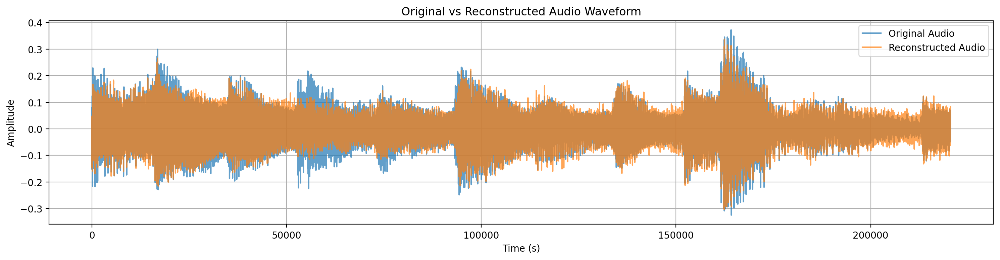

In [21]:
plt.figure(figsize=(15, 4))
plt.plot(crop_audio, alpha = 0.7, label = 'Original Audio')
plt.plot(pred_audio, alpha = 0.7, label = 'Reconstructed Audio')
plt.title("Original vs Reconstructed Audio Waveform")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.legend()
plt.grid(True) 
plt.tight_layout()
plt.show()

## Evaluation Metrics: RMSE and SNR

To evaluate how accurately the audio was reconstructed, we use:


### 1. Root Mean Squared Error (RMSE)

RMSE measures the average magnitude of the difference between original and reconstructed waveforms. Lower RMSE indicates better quality.

$$
\text{RMSE} = \sqrt{ \frac{1}{N} \sum_{i=1}^{N} (y_i - \hat{y}_i)^2 }
$$



### 2. Signal-to-Noise Ratio (SNR)

SNR tells us how much of the original signal is preserved compared to the error introduced. Higher SNR (in decibels) means cleaner reconstruction.

$$
\text{SNR (dB)} = 10 \cdot \log_{10} \left( \frac{ \frac{1}{N} \sum_{i=1}^{N} y_i^2 }{ \frac{1}{N} \sum_{i=1}^{N} (y_i - \hat{y}_i)^2 } \right)
$$

**Where:**

- $N$: Total number of samples  
- $y_i$: Amplitude of the original audio at sample $i$  
- $\hat{y}_i$: Amplitude of the reconstructed audio at sample $i$



**Good values**:
- RMSE close to **0** means accurate reconstruction.  
- SNR above **10 dB** is decent, and **20 dB or more** is very good.


In [22]:
# RMSE Calculation
def calculate_rmse(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    rmse = np.sqrt(mse)
    return rmse

# SNR Calculation
def calculate_snr(original, reconstructed):
    noise = original - reconstructed
    signal_power = np.mean(original ** 2)
    noise_power = np.mean(noise ** 2)
    if noise_power == 0:
        return float('inf')
    snr = 10 * np.log10(signal_power / noise_power)
    return snr

In [23]:
# Compute RMSE and PSNR
rmse = calculate_rmse(crop_audio.numpy(), pred_audio)

snr = calculate_snr(crop_audio.numpy(), pred_audio)

print(f"RMSE: {rmse}")
print(f"SNR: {snr}")

RMSE: 0.025721099227666855
SNR: 7.962918281555176


In [ ]:
RMSE: 0.0814216360449791
SNR: 10.483707427978516  #3000 #0.05

In [ ]:
RMSE: 0.07435639202594757
SNR: 6.186579704284668  # 4000 #0.03

In [ ]:
RMSE: 0.07272837311029434
SNR: 5.428902506828308 #10000 #0.04

In [ ]:
RMSE: 0.06698011606931686
SNR: 4.07767653465271 #10000 #0.03

In [ ]:
RMSE: 0.0326249860227108
SNR: 0.6873583048582077 # 10000 #0.01

In [ ]:
RMSE: 3.156354068778455e-05
SNR: 0.5346925854682922